# Capstone Project - The Battle of the Neighborhoods (Week 2)
### Applied Data Science Capstone by IBM/Coursera  

 - Wenzhuo Song  
 - wenzhuosong1996@outlook.com

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)



## Introduction: Business Problem <a name="introduction"></a>

We have learned to analyze data and get data sets by Foursquare API before, and in the final capstone project, we need to analyze an open end task with learned skills. The task is, we have explored New York City and City of Toronto and clustered their own neighborhoods respectively, and now are interested in how similar or dissimilar they are by comparing their neighborhoods. What is more, we also want to know if New York City is more like City of Toronto or Paris or some other multicultural cities and where we should open a restaurant or start business, which is open and depending on our own thoughts.  
    
New York City (often called simply New York) is the most populous city in the United States, which is the center of the New York metropolitan area, the largest metropolitan area in the world by urban landmass, and it has been described as the cultural, financial, and media capital of the world ([Wikipedia](https://en.wikipedia.org/wiki/New_York_City)). Toronto is the capital city of the Canadian province of Ontario, which is the most populous city in Canada and the fourth most populous city in North America and recognized as one of the most multicultural and cosmopolitan cities in the world ([Wikipedia](https://en.wikipedia.org/wiki/Toronto)).   
    
Both of New York City and City of Toronto are internationally famous, so they have many things in common, like various foods and sports, but they may also have their own features because of different geography, countries and cultures. Therefore, with analysis of kinds and numbers of venues of neighborhoods in each city, their own features can be found, which can help us analyze the similarity and dissimilarity and make decisions.

## Data <a name="data"></a>

Based on definition of our problem, important factors in the project are:
* number of venues in the neighborhood
* category of venues in each neighborhood

The above factors will be used to create representation vector of each neighborhood, which will be used to calculate their similarity and cluster neighborhoods.

In [1]:
# The libraries used to scrape the data

In [2]:
import numpy as np
import pandas as pd
import json
from geopy.geocoders import Nominatim
import requests 
from pandas.io.json import json_normalize
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium
import matplotlib.pyplot as plt
%matplotlib inline

### Neighborhood Candidates

Let's first find the latitude & longitude of center of New York City and City of Toronto, using datasets shared by Watson Studio and Foursquare API.

In [3]:
# my Foursquare info
CLIENT_ID = '1QNBWZXCKW43RHFLX4GYWWZXCF2TBX423SI5E0L3WFDXUJPH' # my Foursquare ID
CLIENT_SECRET = 'NAZMCD34B1AXIWR3BAH1GCHDZF5VGCG3JFN1AEMWMKJ3Y3L5' # my Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 1QNBWZXCKW43RHFLX4GYWWZXCF2TBX423SI5E0L3WFDXUJPH
CLIENT_SECRET:NAZMCD34B1AXIWR3BAH1GCHDZF5VGCG3JFN1AEMWMKJ3Y3L5


Firstly, the neighborhoods of New York City is available, which can be used by downloading json file from Watson Studio.

In [4]:
# The code was removed by Watson Studio for sharing.

In [5]:
!wget -q -O 'newyork_data.json' https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DS0701EN-SkillsNetwork/labs/newyork_data.json

In [6]:
with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [7]:
neighborhoods_data = newyork_data['features']
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
neighborhoods = pd.DataFrame(columns=column_names)
for data in neighborhoods_data:
    borough = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [8]:
neighborhoods.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


Now, the neighborhood in the New York City is available, whose neighborhood's name, latitude and longitude is used to scrape the venues's name, location and category.  

The function **getNearbyVenues** is used to get the venues's data in each neighborhood.

In [9]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
        
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [10]:
NY_venues = getNearbyVenues(neighborhoods['Neighborhood'], neighborhoods['Latitude'], neighborhoods['Longitude'])
NY_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop
2,Wakefield,40.894705,-73.847201,Walgreens,40.896528,-73.844700,Pharmacy
3,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
4,Wakefield,40.894705,-73.847201,Dunkin',40.890459,-73.849089,Donut Shop


In [11]:
print('There are {} uniques categories.'.format(len(NY_venues['Venue Category'].unique())))

There are 429 uniques categories.


Now, the venue's name, latitude, longitude and category of each neighborhood in the New York City is available, and the number of existing venue categories is 436. With the folium library, each neighborhood can be visualized in the map.

In [12]:
address = 'New York'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York are 40.7127281, -74.0060152.


Let's visualize the data we have so far: city center location and candidate neighborhood centers:

In [13]:
# create map of Toronto using latitude and longitude values
map_newyork = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood in zip(NY_venues['Venue Latitude'], 
                                   NY_venues['Venue Longitude'], 
                                   NY_venues['Venue']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

Besides, to analyze and cluster neighborhoods, the representation vector of each neighborhood is necessary, whose features show the number of each venue categories, and the number of dimension is the number of all venues categorues, 436. After that, the data will be saved as csv file, which will be used again the the next part.

In [14]:
# one hot encoding
NY_onehot = pd.get_dummies(NY_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
NY_onehot['Neighbourhood'] = NY_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [NY_onehot.columns[-1]] + list(NY_onehot.columns[:-1])
NY_onehot = NY_onehot[fixed_columns]

NY_onehot.head()

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,...,Warehouse Store,Waste Facility,Waterfront,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [15]:
NY_grouped = NY_onehot.groupby('Neighbourhood').sum().reset_index()
NY_grouped.head()

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,...,Warehouse Store,Waste Facility,Waterfront,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Allerton,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Annadale,0,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Arden Heights,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Arlington,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Arrochar,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
# save the NYC data
NY_grouped.to_csv('NV_grouped.csv', index=False)

OK, we now have all important data of New York City, and that of City of Toronto can be get by the same way.  

The neighborhoods of City of Toronto can be scraped from the [Wikipedia](https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M).

In [17]:
df = pd.read_html('https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M')[0]
df_clean = df.drop(df[df['Borough'].str.contains('Not assigned')].index).reset_index(drop=True)

In [18]:
# define a function to update the neighbourhood
def update_neighbourhood(row):
    if row['Neighbourhood'] == 'Not assigned':
        return row['Borough']
    else:
        return row['Neighbourhood']
df_clean['Neighbourhood'] = df_clean.apply(update_neighbourhood, axis=1)

In [19]:
# read the csv file
geospatial_coordinates = pd.read_csv('Geospatial_Coordinates.csv')
# merge the dataframe
df_final = pd.merge(df_clean, geospatial_coordinates, on=['Postal Code'])
# change name of the first column
df_final.rename(columns={'Postal Code': 'PostalCode'}, inplace=True)

In [20]:
toronto_data = df_final
toronto_data.head()

,PostalCode,Borough,Neighbourhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494


Now, the neighborhood in the City of Toronto is available, whose neighborhood's name, latitude and longitude is used to scrape the venues's name, location and category.

In [21]:
neighbourhood_lists = []
for i in toronto_data.Neighbourhood:
    neighbourhood_lists += i.split(', ')

In [22]:
neighbourhood_latitude = []
neighbourhood_longitude = []
delete_list = []
for neighbourhood in neighbourhood_lists:
    address = '{}, Toronto, Ontario'.format(neighbourhood)
    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    try:
        neighbourhood_latitude.append(location.latitude)
        neighbourhood_longitude.append(location.longitude)
    except:
        delete_list.append(neighbourhood)

In [23]:
neighbourhood_lists = [temp for temp in neighbourhood_lists if temp not in delete_list]
toronto_neighbourhood = pd.DataFrame({'Neighbourhood': neighbourhood_lists,
                                      'Latitude': neighbourhood_latitude, 
                                      'Longitude': neighbourhood_longitude})
toronto_neighbourhood.head()

,Neighbourhood,Latitude,Longitude
0,Parkwoods,43.758800,-79.320197
1,Victoria Village,43.732658,-79.311189
2,Regent Park,43.660706,-79.360457
3,Harbourfront,43.640080,-79.380150
4,Lawrence Manor,43.722079,-79.437507


In [87]:
toronto_venues = getNearbyVenues(toronto_neighbourhood['Neighbourhood'], 
                                 toronto_neighbourhood['Latitude'], 
                                 toronto_neighbourhood['Longitude'])
toronto_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.7588,-79.320197,Allwyn's Bakery,43.759840,-79.324719,Caribbean Restaurant
1,Parkwoods,43.7588,-79.320197,LCBO,43.757774,-79.314257,Liquor Store
2,Parkwoods,43.7588,-79.320197,Shoppers Drug Mart,43.760857,-79.324961,Pharmacy
3,Parkwoods,43.7588,-79.320197,Petro-Canada,43.757950,-79.315187,Gas Station
4,Parkwoods,43.7588,-79.320197,TD Canada Trust,43.757569,-79.314976,Bank


In [88]:
address = 'Toronto'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto are 43.6534817, -79.3839347.


In [92]:
# create map of Toronto using latitude and longitude values
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood in zip(toronto_venues['Venue Latitude'], 
                                   toronto_venues['Venue Longitude'], 
                                   toronto_venues['Venue']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_toronto)  
    
map_toronto

Besides, to analyze and cluster neighborhoods, the representation vector of each neighborhood is necessary, whose features show the number of each venue categories, and the number of dimension is the number of all venues categorues, 327. After that, the data will be saved as csv file, which will be used again the the next part.

In [27]:
# ont hot encoding
toronto_onehot = pd.get_dummies(toronto_venues['Venue Category'], prefix='', prefix_sep='')

# add neighbourhood column back to the dataframe
toronto_onehot['Neighbourhood'] = toronto_venues['Neighborhood']

# move neighbourhood column to the first column
fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
toronto_onehot = toronto_onehot[fixed_columns]

toronto_onehot.head()

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport,Airport Service,American Restaurant,Animal Shelter,...,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Wine Bar,Wings Joint,Women's Store,Yoga Studio
0,Parkwoods,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Parkwoods,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Parkwoods,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Parkwoods,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Parkwoods,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [28]:
toronto_grouped = toronto_onehot.groupby(['Neighbourhood']).sum().reset_index()
toronto_grouped.head()

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport,Airport Service,American Restaurant,Animal Shelter,...,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Wine Bar,Wings Joint,Women's Store,Yoga Studio
0,Adelaide,0,0,0,0,0,0,0,4,0,...,1,0,0,0,0,0,1,0,0,0
1,Agincourt,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
2,Agincourt North,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
3,Albion Gardens,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Alderwood,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [29]:
# save the Toronto data
toronto_grouped.to_csv('Toronto_grouped.csv', index=False)

Looking good. So now we have all information of neighborhoods in New York City and City of Toronto.

This concludes the data gathering phase - we're now ready to use this data for analysis to find the similarity and differences between two cities.

## Methodology <a name="methodology"></a>

In this part, the main work is to cluster neighborhoods of two cities.

In first step, although the representation vector of two cities is available, the features dimension is defferent. Therefore, before cluster works, all neighborhoods vector should be converted into the same dimesion field.

Second step in our analysis will be dimension reduction. The representation vector is sparse, which means that only several items are not zero, and the number of dimension is too high. **Principal Component Analysis (PCA)** is the most commonly used method of linear dimensionality reduction. Its goal is to map high-dimensional data to a low-dimensional space through a certain linear projection, and expect the variance of the data in the projected dimension the largest, then the vector can retain the characteristics of original data points with fewer dimensions.  

In third and final step we will focus on how to cluster different neighborhood based on low-dimensional vector: we do not think all of neighborhoods have to be clustered, actually only some of them are similar while most of them are different because of geographical and cultural fators, so we will calculate the distance and density of neighborhoods' vectors and then use **Density-Based Spatial Clustering of Applications with Noise (DBSCAN) instead of KMeans** to cluster them. DBSCAN is a density-based spatial clustering algorithm, it can divide the regions with sufficient density into clusters, and find clusters of arbitrary shapes in the noisy spatial database. It defines the clusters as the largest collection of densely connected points. 

## Analysis <a name="analysis"></a>

### 1. Combine datasets

In [30]:
NY_df = pd.read_csv('NV_grouped.csv')
TRT_df = pd.read_csv('Toronto_grouped.csv')

In [31]:
same_columns = [i for i in NY_df.columns if i in TRT_df.columns]

In [32]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    length = len([i for i in row_categories_sorted.values if i != 0])
    num_top_venues = min(num_top_venues, length)
    return row_categories_sorted.index.values[0:num_top_venues], row_categories_sorted.values[0:num_top_venues]

In [33]:
num_top_venues = 9

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
# NY_venues_sorted = pd.DataFrame(columns=columns)
# TRT_venues_sorted = pd.DataFrame(columns=columns)

NY_venues_sorted = []
NY_number_sorted = []
TRT_venues_sorted = []
TRT_number_sorted = []

for ind in np.arange(NY_df.shape[0]):
    venues, numbers = return_most_common_venues(NY_df.iloc[ind, :], num_top_venues)
    NY_venues_sorted.append(venues)
    NY_number_sorted.append(numbers)
    

for ind in np.arange(TRT_df.shape[0]):
    venues, numbers = return_most_common_venues(TRT_df.iloc[ind, :], num_top_venues)
    TRT_venues_sorted.append(venues)
    TRT_number_sorted.append(numbers)

In [34]:
venues_bags = []
cities = []
for i in NY_venues_sorted:
    venues_bags.append(list(i))
    cities.append(0)
for i in TRT_venues_sorted:
    venues_bags.append(list(i))
    cities.append(1)

venue_dict = []
for i in venues_bags:
    venue_dict += i
venue_dict = list(set(venue_dict))

In [35]:
NY_vec, TRT_vec = [], []
for i in range(len(NY_venues_sorted)):
    loc = [venue_dict.index(k) for k in NY_venues_sorted[i]]
    vec = [0] * len(venue_dict)
    for j in range(len(loc)):
        vec[loc[j]] = NY_number_sorted[i][j]
    NY_vec.append(vec)

for i in range(len(TRT_venues_sorted)):
    loc = [venue_dict.index(k) for k in TRT_venues_sorted[i]]
    vec = [0] * len(venue_dict)
    for j in range(len(loc)):
        vec[loc[j]] = TRT_number_sorted[i][j]
    TRT_vec.append(vec)   

In [36]:
NY_vec = np.array(NY_vec).reshape(-1, len(venue_dict))
TRT_vec = np.array(TRT_vec).reshape(-1, len(venue_dict))

In [37]:
X = np.concatenate((NY_vec, TRT_vec), axis=0)
y = np.array([0] * NY_vec.shape[0] + [1] * TRT_vec.shape[0]).reshape(-1, 1)
X.shape

(494, 308)

Now two cities' neighborhoods are combined into the same feature space, it is sparse and there are 494 instances but 309 features. In this case, the dimensionality reduction is necessary, because the high-latitude space samples are sparse, which makes it difficult for models to find data features, and it also leads to problems such as a relatively large amount of calculation and long training time. Therefore, we will use PCA to reduce the dimension of space.

### 2. PCA dimension reduction

In [38]:
from sklearn.decomposition import PCA

In the PCA() function, the parameter '**n_components**' is important, it can help us specify the number of feature dimensions that we want after PCA reduction. The most commonly used method is to directly specify the number of dimensions, in this case, 'n_components' is an integer greater than or equal to 1. In addition, we can also specify the variance of the principal components and the minimum proportion threshold, and let the PCA class determine the number of dimensions according to the variance of the sample characteristics, and 'n_components' is a number between (0, 1]. Besides, we can also set the parameter to "mle", at this time the PCA class will use the MLE algorithm to select a certain number of principal component features to reduce dimensionality according to the variance distribution of the features.

In [39]:
pca = PCA(n_components=2)
X_PCA = pca.fit_transform(X)

In [40]:
X_PCA.shape

(494, 2)

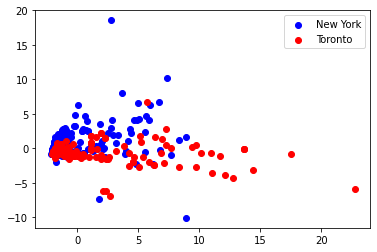

In [41]:
plt.scatter(X_PCA[:NY_vec.shape[0], 0], X_PCA[:NY_vec.shape[0], 1], c='blue', label='New York')
plt.scatter(X_PCA[NY_vec.shape[0]:, 0], X_PCA[NY_vec.shape[0]:, 1], c='red', label='Toronto')
plt.legend()

In the above graph, some neighborhoods of New York and Toronto are very similar, while others are very different, even some in the same city are very distant, so in the cluster analysis, DBSCAN will be a good choise to cluster them. 

### 3. Cluster neighborhoods

In [42]:
from sklearn.cluster import DBSCAN

Firstly, it is important to select parameters for the DBSCAN model. In addition to data set, DBSCAN includes two parameters to select according to situations: '**min_samples**', the minimum number of neighborhood points to become core ones, '**eps**', neighborhood radius. 

In [43]:
res = []
for eps in np.arange(0.001, 1, 0.05):
    for min_samples in range(2, 5):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        dbscan.fit(X_PCA)
        n_clusters = len([i for i in set(dbscan.labels_) if i != -1])
        outliners = np.sum(np.where(dbscan.labels_ == -1, 1,0))
        stats = str(pd.Series([i for i in dbscan.labels_ if i != -1]).value_counts().values)
        res.append({'eps':eps,'min_samples':min_samples,'n_clusters':n_clusters,'outliners':outliners,'stats':stats})     
df = pd.DataFrame(res)
df[df.n_clusters > 1]

,eps,min_samples,n_clusters,outliners,stats
0,0.001,2,21,443,[5 4 3 3 3 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2]
1,0.001,3,6,473,[5 4 3 3 3 3]
2,0.001,4,2,485,[5 4]
3,0.051,2,57,232,[88 10 9 9 8 8 7 5 5 4 4 4 3 3 3 ...
4,0.051,3,23,300,[88 10 9 9 8 8 7 5 5 4 4 4 3 3 3 ...
5,0.051,4,13,335,[88 10 9 7 7 7 5 5 5 4 4 4 4]
6,0.101,2,49,150,[163 16 14 10 9 9 7 7 6 5 4 ...
7,0.101,3,24,200,[163 16 14 10 9 9 7 7 6 5 4 ...
8,0.101,4,16,230,[161 16 13 10 9 9 6 6 5 5 4 ...
9,0.151,2,37,131,[250 11 9 7 5 5 5 4 4 3 3 ...


It is obvious that only several neighborhoods are grouped and the others are set as outliners, which means that there is no significant patterns among neighborhoods. As what discussed above, many neighborhoods have their own features because of many factors, so let's focus on grouped neighborhoods.  

In the above table, 'n_cluters' shows the number of clusters and 'stats' shows the number of neighborhoods in each cluster. With the increasment of 'min_samples', the number of clusters reduces and it only remain some clusters with high number of neighborhoods, which we believe is meaningful to the project.  

In this project, given the consideration ot number of clusters and each size, the 'eps' is set to 0.301 and the 'min_samples' is set to 3.

In [44]:
dbscan = DBSCAN(eps=0.301, min_samples=3)
dbscan.fit(X_PCA)
labels = dbscan.labels_

In [45]:
pd.value_counts(labels)

 0    362
-1     92
 6      8
 7      6
 3      6
 4      4
 2      4
 1      3
 9      3
 8      3
 5      3
dtype: int64

In [46]:
def calculate_city(X, labels):
    calculate_dict = {}
    for i in labels:
        if i == -1:
            continue
        calculate_dict[i] = {}
        for city in X[list(np.where(labels == i)[0]), :]:
            idx = np.where(city > 0)
            for j in idx[0]:
                if venue_dict[j] not in calculate_dict[i]:
                    calculate_dict[i][venue_dict[j]] = city[j]
                else:
                    calculate_dict[i][venue_dict[j]] += city[j]
    return calculate_dict

In [81]:
def calculate_country(X, labels):
    calculate_city = {}
    for i in labels:
        if i == -1:
            continue
        calculate_city[i] = {}
        calculate_city[i]["TRT"] = []
        calculate_city[i]['NY'] = []
        for city in np.where(labels == i)[0]:
            if city < len(NY_vec):
                calculate_city[i]["NY"].append(NY_df.iloc[city].Neighbourhood)
            else:
                calculate_city[i]["TRT"].append(TRT_df.iloc[city-NY_vec.shape[0]].Neighbourhood)
    return calculate_city

In [82]:
city_result = calculate_city(X, labels)
country_result = calculate_country(X, labels)

In [83]:
country_result

{0: {'TRT': ['Agincourt',
   'Agincourt North',
   'Albion Gardens',
   'Alderwood',
   'Bayview Village',
   'Bedford Park',
   'Birch Cliff',
   'Bloordale Gardens',
   'Broadview North (Old East York)',
   'Brockton',
   'Cedarbrae',
   'Clairlea',
   'Clarks Corners',
   'Cliffcrest',
   'Cliffside',
   'Cliffside West',
   'Cloverdale',
   'Dorset Park',
   'Dovercourt Village',
   'Downsview North',
   'East Birchmount Park',
   'Emery',
   'Eringate',
   'Exhibition Place',
   'Forest Hill North & West',
   'Forest Hill Road Park',
   'Forest Hill SE',
   'Glencairn',
   'Guildwood',
   'Henry Farm',
   'High Park',
   'Highland Creek',
   'Humber Bay',
   'Humber Summit',
   'Humber Valley Village',
   'Humbergate',
   'Humberlea',
   'Humewood-Cedarvale',
   'India Bazaar',
   'Ionview',
   'Islington Avenue',
   'Kennedy Park',
   "King's Mill Park",
   'Kingsview Village',
   "L'Amoreaux East",
   "L'Amoreaux West",
   'Lawrence Manor',
   'Lawrence Manor East',
   'Leaside'

There are ten different clusters, and five of them contains both cities of New York City and City of Toronto, while the others are neighborhoods in the same city, which means that there are more similar neighborhoods in City of Toronto.

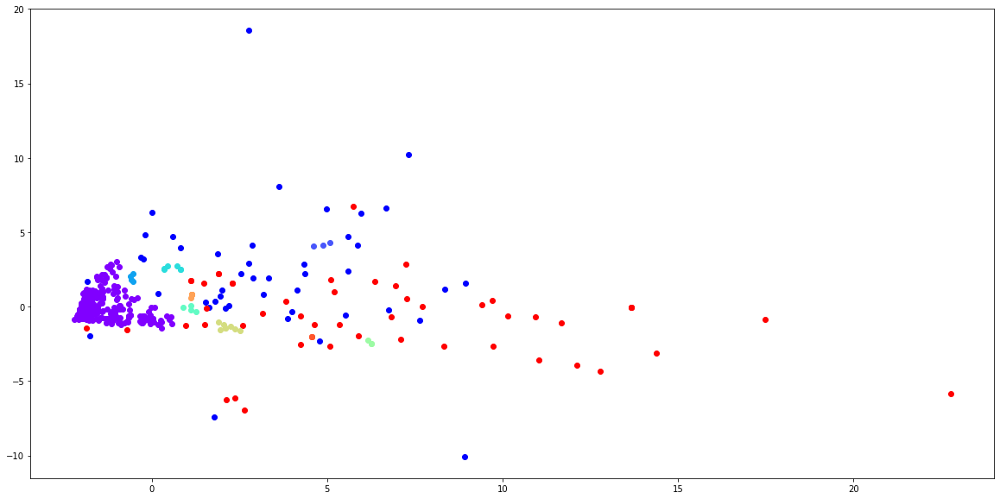

In [84]:
# set color scheme for the clusters
x = np.arange(10)
ys = [i + x + (i*x)**2 for i in range(10)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

plt.figure(figsize=(20, 10))
for i in range(X_PCA.shape[0]):
    color = rainbow[labels[i]]
    if labels[i] == -1:
        if i < NY_vec.shape[0]:
            color='b'
        else:
            color='r'
    plt.scatter(X_PCA[i, 0], X_PCA[i, 1], c=color)

In the above graph, it shows the cluster results, the blue points are neighborhoods that are not clustered in the New York and red points are some not clustered in the Toronto, while other points are grouped with different colors. It is obvious that only some of them are similar, while the others are different, which means that these two cities have some things in common but also some own features.  

Here, we will analyze the cluster that has neighborhoods of both New York and Toronto, and then the rest.

In [85]:
sorted(city_result[0].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Pizza Place', 264),
 ('Chinese Restaurant', 147),
 ('Park', 139),
 ('Deli / Bodega', 130),
 ('Bakery', 128),
 ('Grocery Store', 126),
 ('Pharmacy', 120),
 ('Sandwich Place', 107),
 ('Bank', 107),
 ('Coffee Shop', 99),
 ('Donut Shop', 98),
 ('Bar', 95),
 ('Fast Food Restaurant', 92),
 ('Mexican Restaurant', 72),
 ('Italian Restaurant', 71),
 ('Caribbean Restaurant', 58),
 ('Supermarket', 57),
 ('Bus Stop', 57),
 ('Café', 55),
 ('Bus Station', 55),
 ('Restaurant', 51),
 ('Latin American Restaurant', 49),
 ('Gym', 49),
 ('Beach', 46),
 ('Playground', 42),
 ('Mobile Phone Shop', 41),
 ('Bagel Shop', 39),
 ('Liquor Store', 36),
 ('Indian Restaurant', 33),
 ('Ice Cream Shop', 33),
 ('Sushi Restaurant', 32),
 ('Fried Chicken Joint', 32),
 ('Diner', 31),
 ('Gym / Fitness Center', 30),
 ('Thai Restaurant', 29),
 ('Convenience Store', 29),
 ('Clothing Store', 29),
 ('American Restaurant', 29),
 ('Pub', 28),
 ('Spa', 27),
 ('Seafood Restaurant', 26),
 ('Cosmetics Shop', 26),
 ('Asian Restauran

Cluster 0 has the biggest size of neighborhoods, and there are 362 neighborhoods. According to the summary of venues,the main category is 'Pizza Place', whose number is much higher than the others. Then, 'Chinese Restaurant', 'Park', 'Deli / Bodega', 'Bakery', 'Grocery Store', 'Pharmacy', 'Sandwich Place' and 'Bank' are also over 100 in the cluster. The list of venues shows that the cluster 0 is main about Chinese food and life, and neighborhoods should be around communcities and city centers.

In [63]:
sorted(city_result[4].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Coffee Shop', 11),
 ('Restaurant', 6),
 ('Pizza Place', 6),
 ('Bar', 4),
 ('Yoga Studio', 3),
 ('Thai Restaurant', 2),
 ('Sporting Goods Shop', 2),
 ('Sandwich Place', 2),
 ('Pub', 2),
 ('Mexican Restaurant', 2),
 ('Italian Restaurant', 2),
 ('Indian Restaurant', 2),
 ('Fast Food Restaurant', 2),
 ('Café', 2),
 ('Bakery', 2),
 ('BBQ Joint', 2),
 ('Pet Store', 1),
 ('Movie Theater', 1),
 ('Liquor Store', 1),
 ('Gift Shop', 1),
 ('Fried Chicken Joint', 1),
 ('Ethiopian Restaurant', 1),
 ('Dog Run', 1),
 ('Discount Store', 1),
 ('Caribbean Restaurant', 1),
 ('Bus Stop', 1),
 ('Boutique', 1),
 ('Bagel Shop', 1)]

In the cluster 4, there are four neighborhoods, half of them are from Toronto and the others are from New York. The main venue categories are 'Coffee Shop', 'Restaurant', 'Pizza Place' and 'Bar', and given the other venues in this cluster, the cluster 4 is mainly about the food and alcohol. Besides, the topic of cluster 4 is similar with that of cluster 0, but we think it focuses on food more.

In [64]:
sorted(city_result[5].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Coffee Shop', 22),
 ('Hotel', 8),
 ('Gym', 7),
 ('Japanese Restaurant', 6),
 ('Grocery Store', 6),
 ('Clothing Store', 6),
 ('Theater', 4),
 ('Sandwich Place', 4),
 ('Restaurant', 4),
 ('Fried Chicken Joint', 4),
 ('Fast Food Restaurant', 4),
 ('Burger Joint', 4),
 ('Steakhouse', 3),
 ('Sporting Goods Shop', 3),
 ('Bookstore', 3),
 ('Bakery', 3)]

In the cluster 5, there are three neighborhoods, two of them are from Toronto and one is from New York. The main venues are 'Coffee Shop', 'Hotel', 'Gym', 'Japanese Restaurant' and stores, and the cluster 5 is about food and shopping. Therefore, this cluster should be in the city center area.

In [65]:
sorted(city_result[6].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Coffee Shop', 28),
 ('Café', 15),
 ('Restaurant', 14),
 ('Clothing Store', 11),
 ('Park', 7),
 ('Gym', 4),
 ('Grocery Store', 4),
 ('Vegetarian / Vegan Restaurant', 3),
 ('Pub', 3),
 ('Mexican Restaurant', 3),
 ('French Restaurant', 3),
 ('Dessert Shop', 3),
 ('Bookstore', 3),
 ('American Restaurant', 3),
 ('Vietnamese Restaurant', 2),
 ('Thai Restaurant', 2),
 ('Optical Shop', 2),
 ('Museum', 2),
 ('Japanese Restaurant', 2),
 ('Harbor / Marina', 2),
 ('Food Truck', 2),
 ('Department Store', 2),
 ('Business Service', 2),
 ('Burrito Place', 2),
 ('Burger Joint', 2),
 ('Boutique', 2),
 ('Bar', 2),
 ('Sporting Goods Shop', 1),
 ('Sculpture Garden', 1),
 ('Ramen Restaurant', 1),
 ('Paper / Office Supplies Store', 1),
 ('Outdoor Sculpture', 1),
 ('Italian Restaurant', 1),
 ('Food Court', 1),
 ('Fast Food Restaurant', 1),
 ('Falafel Restaurant', 1),
 ('Discount Store', 1),
 ('Diner', 1),
 ('Bubble Tea Shop', 1),
 ('Bakery', 1),
 ('Athletics & Sports', 1)]

In the cluster 6, there are eight neighborhoods, and seven of them are from Toronto. The main venues are 'Coffee Shop', 'Cafe', 'Restaurant' and 'Cloth Store', and the cluster is also about food and shopping, which is similar cluster 4 and 5.

In [66]:
sorted(city_result[7].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Coffee Shop', 18),
 ('Italian Restaurant', 12),
 ('Breakfast Spot', 12),
 ('Bank', 12),
 ('Sushi Restaurant', 10),
 ('Pub', 10),
 ('Dessert Shop', 10),
 ('Liquor Store', 5),
 ('French Restaurant', 5),
 ('Pharmacy', 2),
 ('Music Store', 2),
 ('Bar', 2),
 ('Mexican Restaurant', 1),
 ('Burger Joint', 1)]

In the cluster 7, there are six neighborhoods and only one is from New York. Like the above clusters, the main venues are also 'Coffee Shop', restaurant, bank and stores, and the cluster 7 is also about life and Italian / Japanese food.  

Now, all clusters containing neighborhoods from both New York and Toronto have been summarized, and they are all about food, life and shopping in some degree. Next, the cluster 1, 2 and 3 only have New York neighborhoods, and cluster 8 and 9 are from Toronto.

In [67]:
sorted(city_result[1].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Italian Restaurant', 17),
 ('Coffee Shop', 16),
 ('Gym / Fitness Center', 9),
 ('Theater', 7),
 ('Gym', 7),
 ('Pizza Place', 6),
 ('Art Gallery', 5),
 ('Wine Shop', 4),
 ('Park', 4),
 ('Mexican Restaurant', 4),
 ('American Restaurant', 4),
 ('Sushi Restaurant', 3),
 ('Sandwich Place', 3),
 ('Hotel', 3),
 ('Furniture / Home Store', 3),
 ('Cocktail Bar', 3),
 ('Bookstore', 3),
 ('Bakery', 3),
 ('Yoga Studio', 2),
 ('Beer Bar', 2)]

In [68]:
sorted(city_result[2].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Deli / Bodega', 14),
 ('Bakery', 11),
 ('Pizza Place', 9),
 ('Café', 8),
 ('Cocktail Bar', 4),
 ('Bar', 4),
 ('Sandwich Place', 3),
 ('Pharmacy', 3),
 ('Italian Restaurant', 3),
 ('Concert Hall', 3),
 ('Caribbean Restaurant', 3),
 ('Wine Shop', 2),
 ('Sushi Restaurant', 2),
 ('Restaurant', 2),
 ('Mobile Phone Shop', 2),
 ('Mexican Restaurant', 2),
 ('Indian Restaurant', 2),
 ('Gym / Fitness Center', 2),
 ('Grocery Store', 2),
 ('Burger Joint', 2),
 ('Bank', 2),
 ('Donut Shop', 1),
 ('Coffee Shop', 1),
 ('Bookstore', 1)]

In [69]:
sorted(city_result[3].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Italian Restaurant', 20),
 ('Café', 13),
 ('Bakery', 12),
 ('Chinese Restaurant', 10),
 ('Gym / Fitness Center', 7),
 ('Bar', 7),
 ('Wine Shop', 6),
 ('Theater', 6),
 ('Coffee Shop', 6),
 ('Cocktail Bar', 6),
 ('Plaza', 5),
 ('Yoga Studio', 4),
 ('Wine Bar', 4),
 ('Performing Arts Venue', 4),
 ('Hotel', 4),
 ('Concert Hall', 4),
 ('Bubble Tea Shop', 4),
 ('Salon / Barbershop', 3),
 ('Pizza Place', 3),
 ('Mediterranean Restaurant', 3),
 ('Indie Movie Theater', 3),
 ('Furniture / Home Store', 3),
 ('French Restaurant', 3),
 ('Flower Shop', 3),
 ('Deli / Bodega', 3),
 ('Thai Restaurant', 2),
 ('Spa', 2),
 ('Seafood Restaurant', 2),
 ('Opera House', 2),
 ('Martial Arts School', 2),
 ('Bank', 2),
 ('Bagel Shop', 2),
 ('Art Gallery', 2),
 ('Ice Cream Shop', 1)]

The above three clusters are from New York. In the cluster 1, the main venues are 'Italian Restaurant', 'Coffee Shop', 'Gym / Fitness Center' and 'Theater', and it is about Italian food and life. In the cluster 2, the main venues are 'Deli / Bodega', 'Bakery', 'Pizza Place' and 'Café'. In the cluster 3, the main venues are 'Italian Restaurant', 'Cafe', 'Bakery' and 'Chinese Restaurant'.

In [70]:
sorted(city_result[8].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Clothing Store', 21),
 ('Coffee Shop', 18),
 ('Theater', 6),
 ('Restaurant', 6),
 ('Plaza', 6),
 ('Diner', 6),
 ('Cosmetics Shop', 6),
 ('American Restaurant', 6),
 ('Seafood Restaurant', 3)]

In [71]:
sorted(city_result[9].items(), key = lambda kv:(kv[1], kv[0]), reverse=True)

[('Coffee Shop', 42),
 ('Café', 15),
 ('Restaurant', 12),
 ('Hotel', 12),
 ('Pizza Place', 9),
 ('Italian Restaurant', 9),
 ('Sushi Restaurant', 6),
 ('Sports Bar', 6),
 ('Sporting Goods Shop', 6)]

The above two clusters are from Toronto. In the cluster 8, the main venues are 'Clothing Store' and 'Coffee Shop', so it is about cloth shopping. In the cluster 9, the main venues are 'Coffee Shop', 'Hotel' and kinds of restaurants.

## Results and Discussion <a name="results"></a>

There are two interesting ideas in this project, the first one is to compare the neighborhoods of the two cities and determine how similar or dissimilar they are, and the seconde one is to recommend a place if someone if looking to open a restaurant or start a constraction business.  

Generally speaking, New York City and City of Toronto are very similar. We have clustered neighborhoods based on density of their representation vectors, and most of them are similar in some aspects, like food and shopping. Speciafically, in terms of food, Chinese restaurant is very popular in both of New York and Toronto, Italian restaurant is more popular in New York compared that in Toronto, and the number of kinds of restaurant in the New York is more than that in the Toronto.  

Therefore, according to the cluster result, if someone is looking to open a restaurant, the neighborhood in the cluster 0 would be a good choice, where there are multiple kinds and might also be competed. Besides, if it is Italian food, Toronto might be a better choice because the market there is still empty. What is more, if someone is looking to start a constraction business, he or she cannot get the answer from here. The neighborhoods in the cluster 0 might be possible because there are some constraction items, but because of low density of constraction stall in the dataset, it is difficult to select an optimal neighborhoods for such business.

## Conclusion <a name="conclusion"></a>

Purpose of this project was to identify the similarity and difference bewteen New York City and City of Toronto and then recommend some places according to demands. Firstly, the neighborhoods and their venue features need to be scraped from Foursquare API, and then their venue feature vector should be converted into the same space, by which the raw neighborhoods' representation vectors are available. Secondly, before calculating density and similarity of neighborhoods, the dimension of vectors should be reduced because it is sparse and too high comapred with the number of instances, and Principal Component Analysis method can help reduce dimensions and contain at most important information. Then, because we think only some neighborhoods are similar in some degree while others are different because of different culture and geography, so Density-Based Spatial Clustering of Applications with Noise method is used to cluster them, which can not only find similar neighborhoods but also label ones that are different from others as outliers, and it helps us find the similarity of two cities and recommends some places depending on our demands.

On the other hand, because of lack of neighborhoods, it is almost impossilbe to find the similarity between different venues, for instance, Chinese restaurant and Japanese restaurant should be very similar, but they are totally different in the representation, which can bring negative influence on cluster works and make the result in this project not reasonable. We think if there are more neighborhoods information, with embedding venues inforamtion, the model can cluster neighborhoods much clearly and find more accurate and interesting stories.